<a href="https://colab.research.google.com/github/matyi101/price_catcher/blob/main/Selangor_Price_Catcher_2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [255]:
from google.colab import drive
drive.mount('/content/drive/')
path = "/content/drive/MyDrive/Colab Notebooks/price_catcher/"

from google.colab import data_table
data_table.enable_dataframe_formatter()

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [256]:
import os
import pandas as pd

import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

'''
plt.rcParams["figure.figsize"] = (20,4)
plt.rcParams["figure.dpi"] = 100
plt.rcParams["axes.grid"] = True
'''

'\nplt.rcParams["figure.figsize"] = (20,4)\nplt.rcParams["figure.dpi"] = 100\nplt.rcParams["axes.grid"] = True\n'

In [257]:
#Load Data
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/price_catcher/data/selangor_2022/input_data.csv')
df['date'] = pd.to_datetime(df['date'])
df.info()
df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2898270 entries, 0 to 2898269
Data columns (total 8 columns):
 #   Column         Dtype         
---  ------         -----         
 0   date           datetime64[ns]
 1   premise        object        
 2   premise_type   object        
 3   district       object        
 4   state          object        
 5   item           object        
 6   item_category  object        
 7   price          float64       
dtypes: datetime64[ns](1), float64(1), object(6)
memory usage: 176.9+ MB


,date,premise,premise_type,district,state,item,item_category,price
0,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,AYAM BERSIH - STANDARD,AYAM,8.95
1,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,BETIK BIASA,BUAH-BUAHAN,3.95
2,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,TEMBIKAI MERAH TANPA BIJI,BUAH-BUAHAN,2.29
3,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,TEMBIKAI SUSU,BUAH-BUAHAN,5.45
4,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,NENAS BIASA (JOSAPINE/MORRIS/SARAWAK),BUAH-BUAHAN,2.35


In [258]:
# Check for duplicate data
duplicates = df.duplicated()

# Display the rows with duplicate data
print(df[duplicates])

              date                      premise              premise_type  \
3424    2022-01-01                LOTUSS STORES               Hypermarket   
15223   2022-01-01  MEGAH SUPERMARKET (BANTING)  Pasar Raya / Supermarket   
15268   2022-01-01  MEGAH SUPERMARKET (BANTING)  Pasar Raya / Supermarket   
31255   2022-01-03                LOTUSS STORES               Hypermarket   
95856   2022-01-10                LOTUSS STORES               Hypermarket   
...            ...                          ...                       ...   
2742323 2022-12-09       MYDIN MART PADANG JAWA  Pasar Raya / Supermarket   
2800922 2022-12-19               MYDIN SELAYANG               Hypermarket   
2808653 2022-12-19       MYDIN MART PADANG JAWA  Pasar Raya / Supermarket   
2854811 2022-12-24    GIANT SEKSYEN 7 SHAH ALAM  Pasar Raya / Supermarket   
2862176 2022-12-27    GIANT SEKSYEN 7 SHAH ALAM  Pasar Raya / Supermarket   

             district     state                                item  \
3424

In [282]:
df = df.drop_duplicates()
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2154085 entries, 0 to 2898267
Data columns (total 8 columns):
 #   Column         Dtype         
---  ------         -----         
 0   date           datetime64[ns]
 1   premise        object        
 2   premise_type   object        
 3   district       object        
 4   state          object        
 5   item           object        
 6   item_category  object        
 7   price          float64       
dtypes: datetime64[ns](1), float64(1), object(6)
memory usage: 147.9+ MB


In [283]:
categories = df['item_category'].unique()
categories

array(['AYAM', 'BUAH-BUAHAN', 'BAHAN LAUT', 'IKAN DARAT', 'SAYUR-SAYURAN',
       'TELUR', 'IKAN DALAM TIN', 'MINYAK DAN LEMAK', 'ROTI', 'TEPUNG',
       'BERAS', 'DAGING', 'MEE/KUETIAU', 'GULA', 'MENTEGA', 'MI SEGERA',
       'HASIL LAUT KERING'], dtype=object)

In [261]:
# Select specific item categories
selected_categories = ['AYAM', 'BUAH-BUAHAN', 'BAHAN LAUT', 'IKAN DARAT', 'SAYUR-SAYURAN','TELUR','IKAN DALAM TIN', 'MINYAK DAN LEMAK',
                       'ROTI','TEPUNG', 'BERAS', 'DAGING', 'MEE/KUETIAU','GULA', 'MENTEGA', 'MI SEGERA','HASIL LAUT KERING']
df = df[df['item_category'].isin(selected_categories)]

In [285]:
summary_stats = df.groupby('item_category')['price'].describe()
summary_stats

,count,mean,std,min,25%,50%,75%,max
item_category,,,,,,,,
AYAM,119903.0,14.603630,5.081085,3.93,10.99,14.90,16.90,45.90
BAHAN LAUT,442812.0,26.897716,12.935648,0.99,15.90,24.90,36.00,99.00
BERAS,19346.0,22.755821,9.060180,4.00,23.88,25.90,26.00,52.00
BUAH-BUAHAN,215444.0,5.446411,3.218147,0.60,3.30,5.00,6.99,29.90
DAGING,85461.0,30.647856,11.896659,9.40,20.00,27.00,39.90,74.50
GULA,12029.0,2.747776,0.288340,1.79,2.55,2.85,2.95,4.00
HASIL LAUT KERING,36202.0,21.404827,15.822081,4.49,6.99,19.99,33.50,75.00
IKAN DALAM TIN,28087.0,6.733797,2.012315,2.61,4.45,7.09,8.65,11.20
IKAN DARAT,52997.0,11.862685,4.391600,0.08,8.90,10.90,14.90,36.00


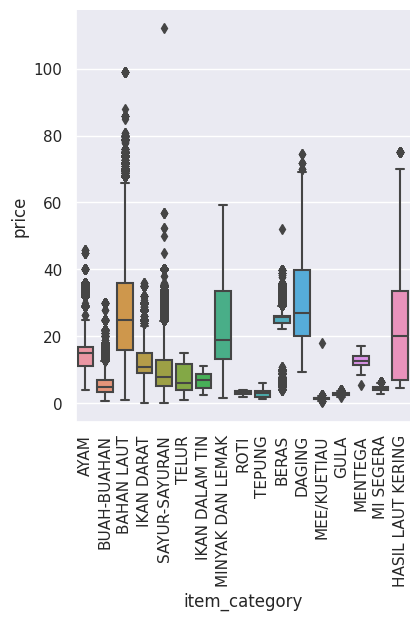

In [286]:
sns.catplot(x="item_category", y="price", kind="box", data=df)
plt.xticks(rotation=90)
# Display the plot
plt.show()

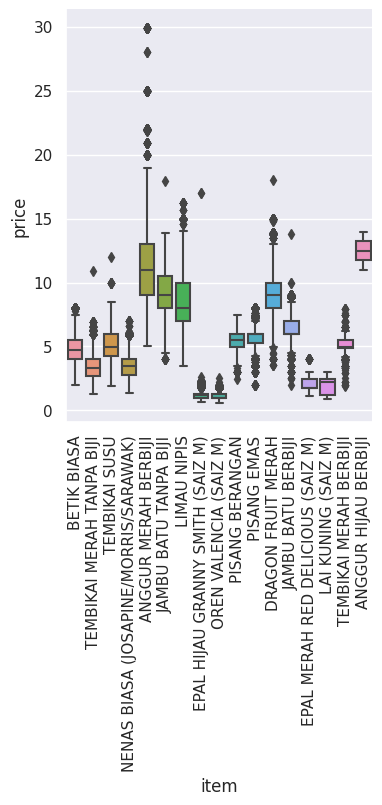

In [299]:
buah = df[df["item_category"]=="BUAH-BUAHAN"]
sns.catplot(x="item", y="price", kind="box", data=buah)
plt.xticks(rotation=90)
# Display the plot
plt.show()

In [305]:
import plotly.express as px
seafood = df[df["item_category"]=="BAHAN LAUT"]

# Create a box plot
fig = px.box(seafood, x="item", y="price")

fig.show()


In [307]:
# Interest: Ikan Kembung
kembung = df[df["item"].str.contains("KEMBUNG", na=False)]
kembung

,date,premise,premise_type,district,state,item,item_category,price
1050,2022-01-01,AEON BIG SUBANG JAYA,Hypermarket,Petaling,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,11.90
1401,2022-01-01,PASAR SELAYANG BARU,Pasar Basah,Gombak,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,15.00
1530,2022-01-01,PASAR SELAYANG BARU,Pasar Basah,Gombak,Selangor,IKAN KEMBUNG (ANTARA 8 HINGGA 12 EKOR SEKILOGRAM),BAHAN LAUT,20.00
1636,2022-01-01,GIANT BATU CAVES,Hypermarket,Gombak,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,16.99
2026,2022-01-01,GIANT SEKSYEN 7 SHAH ALAM,Pasar Raya / Supermarket,Petaling,Selangor,IKAN KEMBUNG (ANTARA 8 HINGGA 12 EKOR SEKILOGRAM),BAHAN LAUT,16.99
...,...,...,...,...,...,...,...,...
2897705,2022-12-31,BS FRESHMART PETALING JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,14.99
2897745,2022-12-31,BS FRESHMART PETALING JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,IKAN KEMBUNG (ANTARA 8 HINGGA 12 EKOR SEKILOGRAM),BAHAN LAUT,17.99
2897950,2022-12-31,SEGI CASH & CARRY TAMAN TANJAK,Pasar Raya / Supermarket,Hulu Selangor,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,13.90
2898104,2022-12-31,PASARAYA MEGAH DENGKIL,Pasar Raya / Supermarket,Sepang,Selangor,IKAN KEMBUNG KECIL/PELALING (ANTARA 10 HINGGA ...,BAHAN LAUT,12.99


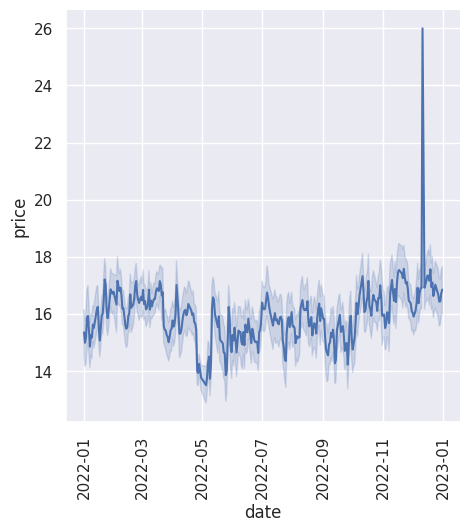

In [308]:
# Setting Plot size and font style:
sns.relplot(x='date', y='price', data=kembung, kind='line')
plt.xticks(rotation=90)
plt.show()

In [313]:
sotong = df[df["item"].str.contains("SOTONG", na=False)]
sotong = sotong[sotong["item_category"]=="BAHAN LAUT"]
sotong

,date,premise,premise_type,district,state,item,item_category,price
75,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,34.95
324,2022-01-01,TESCO SEKSYEN 13,Hypermarket,Petaling,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,29.98
587,2022-01-01,TESCO PUCHONG,Hypermarket,Petaling,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,29.99
841,2022-01-01,PASARAYA ECONSAVE KAPAR SDN BHD,Pasar Raya / Supermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,39.90
1115,2022-01-01,AEON BIG SUBANG JAYA,Hypermarket,Petaling,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,42.90
...,...,...,...,...,...,...,...,...
2897503,2022-12-31,PASAR SUNTEX,Pasar Basah,Hulu Langat,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,38.00
2897612,2022-12-31,GIANT SUPERSTORE PRIMA SAUJANA,Hypermarket,Hulu Langat,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,32.20
2898055,2022-12-31,SEGI FRESH SEKSYEN 23,Pasar Raya / Supermarket,Petaling,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,32.90
2898132,2022-12-31,PASARAYA MEGAH DENGKIL,Pasar Raya / Supermarket,Sepang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,36.99


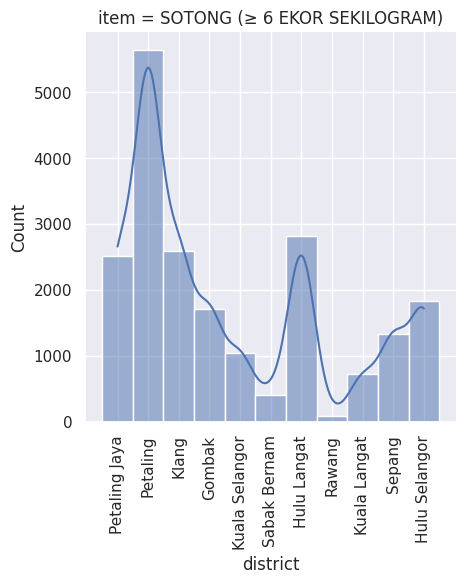

In [315]:
sns.displot(data=sotong, x="district", col="item", kde=True)
plt.xticks(rotation=90)
plt.show()

In [318]:
sotong = sotong[sotong["district"]=="Klang"]
sotong

,date,premise,premise_type,district,state,item,item_category,price
841,2022-01-01,PASARAYA ECONSAVE KAPAR SDN BHD,Pasar Raya / Supermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,39.90
3572,2022-01-01,AEON BIG KAPAR,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,48.80
3971,2022-01-01,TESCO SETIA ALAM,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,28.98
7879,2022-01-01,GIANT BUKIT TINGGI,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,34.99
8275,2022-01-01,TESCO BUKIT TINGGI,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,29.99
...,...,...,...,...,...,...,...,...
2893754,2022-12-31,GIANT BUKIT TINGGI,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,32.20
2893937,2022-12-31,TESCO BUKIT TINGGI,Hypermarket,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,29.99
2894142,2022-12-31,PASAR MERU KLANG,Pasar Basah,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,27.00
2894236,2022-12-31,PASAR BASAH KAPAR,Pasar Basah,Klang,Selangor,SOTONG (≥ 6 EKOR SEKILOGRAM),BAHAN LAUT,38.00


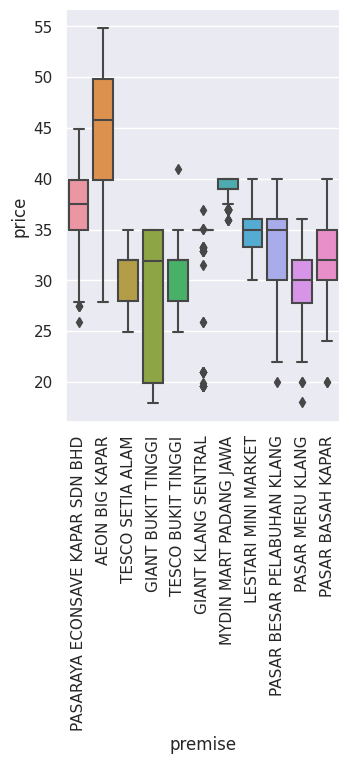

In [319]:
sns.catplot(x="premise", y="price", kind="box", data=sotong)
plt.xticks(rotation=90)
# Display the plot
plt.show()

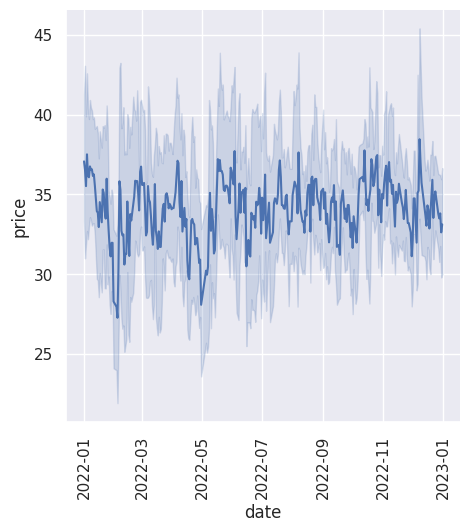

In [320]:
# Setting Plot size and font style:
sns.relplot(x='date', y='price', data=sotong, kind='line')
plt.xticks(rotation=90)
plt.show()

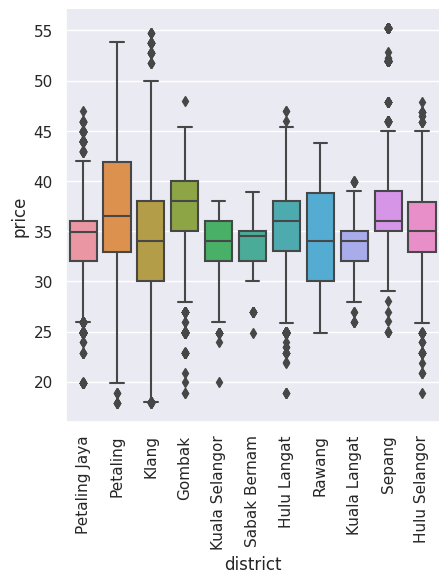

In [317]:
sns.catplot(x="district", y="price", kind="box", data=sotong)
plt.xticks(rotation=90)
# Display the plot
plt.show()

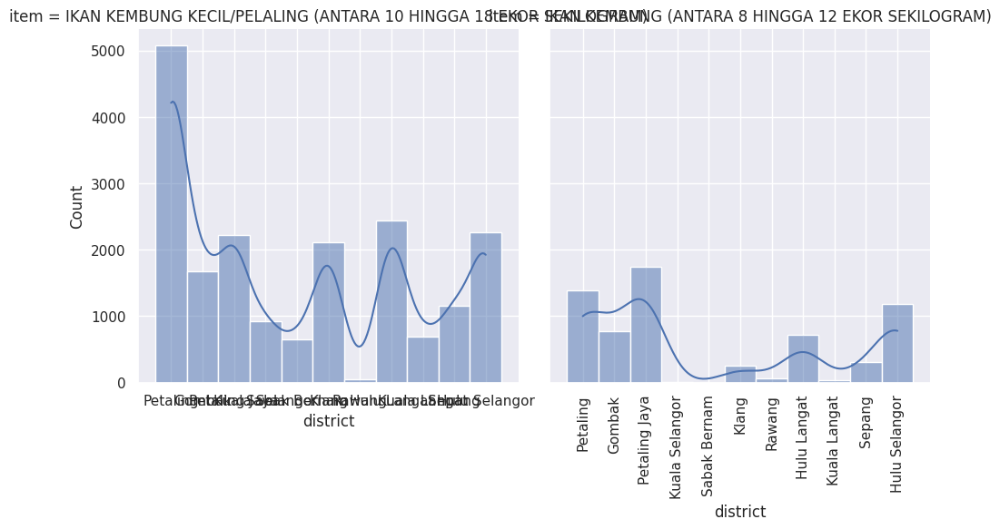

In [310]:
sns.displot(data=kembung, x="district", col="item", kde=True)
plt.xticks(rotation=90)
plt.show()

In [306]:
meat = df[df["item_category"]=="DAGING"]

# Create a box plot
fig = px.box(meat, x="item", y="price")

fig.show()


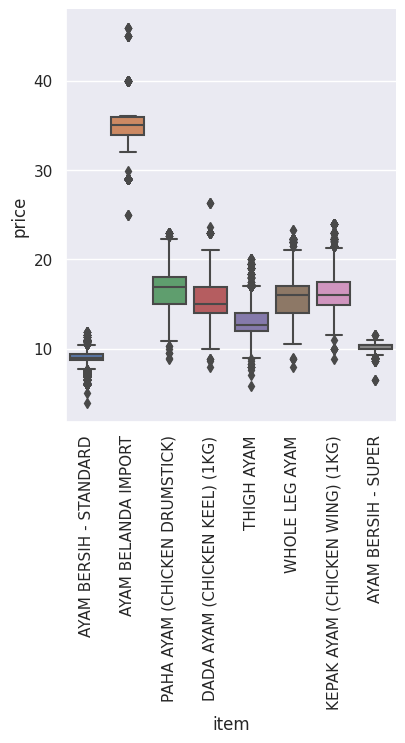

In [297]:
ayam = df[df["item_category"]=="AYAM"]
sns.catplot(x="item", y="price", kind="box", data=ayam)
plt.xticks(rotation=90)
# Display the plot
plt.show()

In [284]:
daging = df[df["item_category"]=="DAGING"]
daging

,date,premise,premise_type,district,state,item,item_category,price
113,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,DAGING LEMBU IMPORT (BLADE),DAGING,35.00
114,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,DAGING KERBAU IMPORT (INDIA) * (SILVERSIDE),DAGING,17.00
115,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,DAGING KERBAU IMPORT (INDIA) * (BLADE),DAGING,17.00
247,2022-01-01,TESCO SEKSYEN 13,Hypermarket,Petaling,Selangor,DAGING KAMBING BEBIRI IMPORT BERTULANG (MUTTON...,DAGING,35.99
375,2022-01-01,TESCO SEKSYEN 13,Hypermarket,Petaling,Selangor,DAGING PAHA KAMBING BEBIRI IMPORT BERTULANG (...,DAGING,37.99
...,...,...,...,...,...,...,...,...
2898011,2022-12-31,SEGI CASH & CARRY TAMAN TANJAK,Pasar Raya / Supermarket,Hulu Selangor,Selangor,DAGING KERBAU IMPORT (INDIA) (BLOCK),DAGING,20.90
2898025,2022-12-31,SEGI FRESH SEKSYEN 23,Pasar Raya / Supermarket,Petaling,Selangor,DAGING KAMBING BEBIRI IMPORT TANPA TULANG (MUT...,DAGING,46.90
2898026,2022-12-31,SEGI FRESH SEKSYEN 23,Pasar Raya / Supermarket,Petaling,Selangor,DAGING KERBAU IMPORT (INDIA) * (TOP SIDE),DAGING,18.50
2898061,2022-12-31,SEGI FRESH SEKSYEN 23,Pasar Raya / Supermarket,Petaling,Selangor,DAGING PAHA KAMBING BEBIRI IMPORT BERTULANG (...,DAGING,36.90


In [263]:
daging.groupby("item").count()

,date,premise,premise_type,district,state,item_category,price
item,,,,,,,
DAGING BABI (DAGING & LEMAK / LEAN & FAT),4164,4164,4164,4164,4164,4164,4164
DAGING BABI (ISI DAGING / PURE LEAN),4158,4158,4158,4158,4158,4158,4158
DAGING BABI (PERUT / BELLY),4077,4077,4077,4077,4077,4077,4077
DAGING BABI (RUSUK DENGAN DAGING/ RIBS WITH MEAT),4355,4355,4355,4355,4355,4355,4355
DAGING KAMBING BEBIRI IMPORT BERTULANG (LAMB) (AUSTRALIA - KOTAK) (1KG),482,482,482,482,482,482,482
DAGING KAMBING BEBIRI IMPORT BERTULANG (LAMB) (NEW ZEALAND - KOTAK),26,26,26,26,26,26,26
DAGING KAMBING BEBIRI IMPORT BERTULANG (MUTTON) (AUSTRALIA - KOTAK),7709,7709,7709,7709,7709,7709,7709
DAGING KAMBING BEBIRI IMPORT BERTULANG (MUTTON) (NEW ZEALAND - KOTAK),122,122,122,122,122,122,122
DAGING KAMBING BEBIRI IMPORT TANPA TULANG (LAMB) (TIDAK TERMASUK PAHA - AUSTRALIA),74,74,74,74,74,74,74


In [264]:
# Interested only with Cat: DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL (KECUALI BATANG PINANG - TENDERLOIN)
daging_lembu = df[df["item"].str.contains("BAHAGIAN 2", na=False)]
daging_lembu

,date,premise,premise_type,district,state,item,item_category,price
1172,2022-01-01,AEON BIG SUBANG JAYA,Hypermarket,Petaling,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,45.9
1522,2022-01-01,PASAR SELAYANG BARU,Pasar Basah,Gombak,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,38.0
2278,2022-01-01,PASAR BESAR JALAN OTHMAN,Pasar Basah,Petaling Jaya,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,30.0
3843,2022-01-01,PASAR KAMPUNG MELAYU SUBANG,Pasar Basah,Petaling,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,40.0
4231,2022-01-01,PASAR BESAR MODEN RAWANG,Pasar Basah,Rawang,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,34.0
...,...,...,...,...,...,...,...,...
2895235,2022-12-31,AEON BIG SEKSYEN 23,Hypermarket,Petaling,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,45.9
2897146,2022-12-31,PASARAYA SEGI FRESH SEMENYIH,Pasar Raya / Supermarket,Hulu Langat,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,41.9
2897428,2022-12-31,SEGI CASH & CARRY SDN BHD (GOMBAK),Pasar Raya / Supermarket,Gombak,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,41.9
2897903,2022-12-31,SEGI CASH & CARRY BUKIT SENTOSA,Pasar Raya / Supermarket,Hulu Selangor,Selangor,DAGING LEMBU TEMPATAN (BAHAGIAN 2 DAGING PEJAL...,DAGING,45.0


([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, 'Petaling'),
  Text(1, 0, 'Gombak'),
  Text(2, 0, 'Petaling Jaya'),
  Text(3, 0, 'Rawang'),
  Text(4, 0, 'Hulu Langat'),
  Text(5, 0, 'Kuala Langat'),
  Text(6, 0, 'Sepang'),
  Text(7, 0, 'Klang'),
  Text(8, 0, 'Hulu Selangor')])

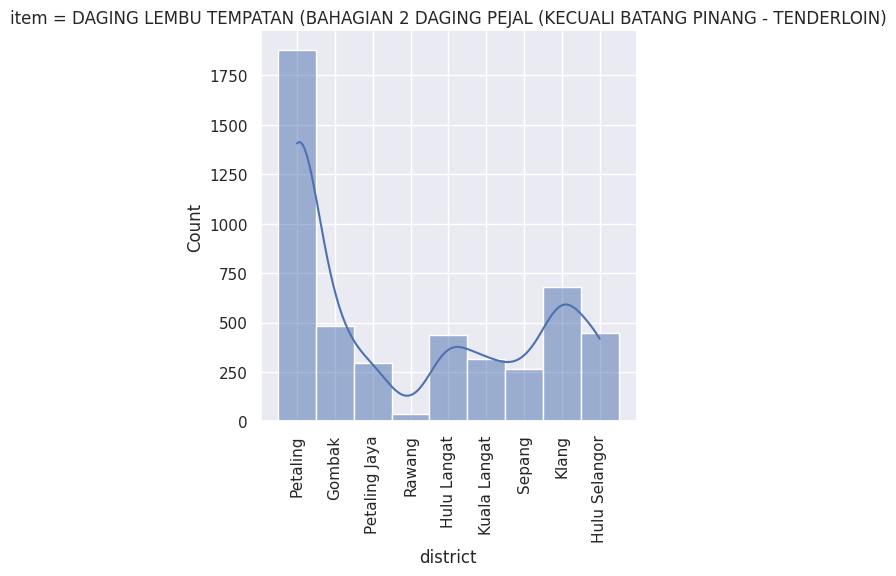

In [265]:
sns.displot(data=daging_lembu, x="district", col="item", kde=True)
plt.xticks(rotation=90)

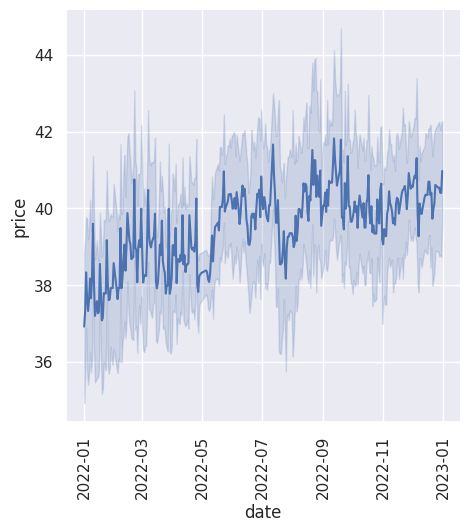

In [266]:
# Setting Plot size and font style:
sns.relplot(x='date', y='price', data=daging_lembu, kind='line')
plt.xticks(rotation=90)
plt.show()

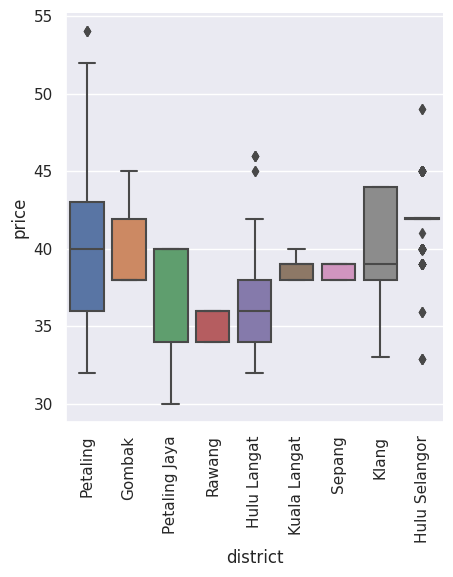

In [267]:

sns.catplot(x="district", y="price", kind="box", data=daging_lembu)
plt.xticks(rotation=90)
plt.show()

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Petaling'),
  Text(1, 0, 'Gombak'),
  Text(2, 0, 'Petaling Jaya'),
  Text(3, 0, 'Rawang'),
  Text(4, 0, 'Hulu Langat'),
  Text(5, 0, 'Kuala Langat'),
  Text(6, 0, 'Sepang'),
  Text(7, 0, 'Klang'),
  Text(8, 0, 'Hulu Selangor')])

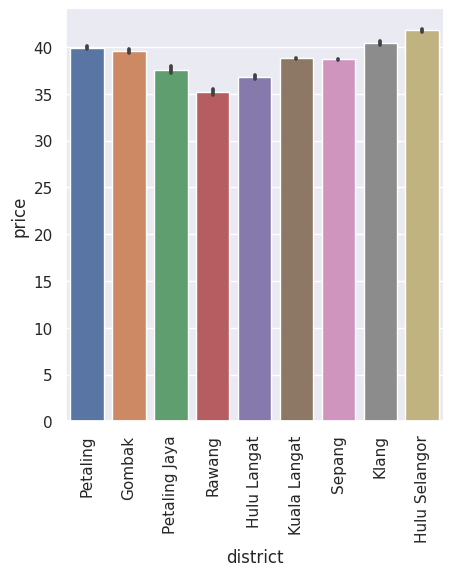

In [268]:
sns.catplot(x="district", y="price", data=daging_lembu, kind="bar")
plt.xticks(rotation=90)

(array([0, 1, 2, 3]),
 [Text(0, 0, 'Hypermarket'),
  Text(1, 0, 'Pasar Basah '),
  Text(2, 0, 'Borong'),
  Text(3, 0, 'Pasar Raya / Supermarket')])

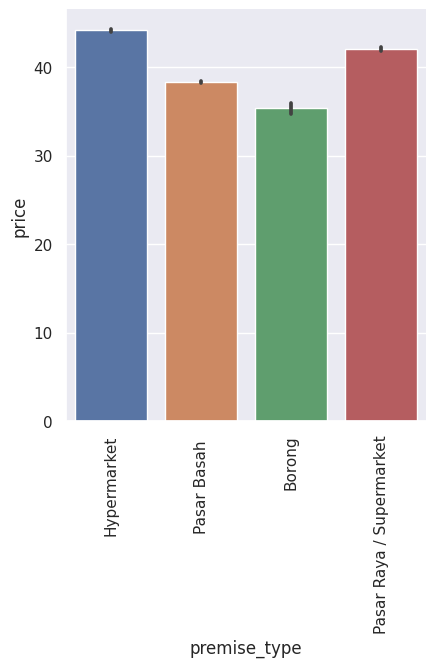

In [269]:
sns.catplot(x="premise_type", y="price", data=daging_lembu, kind="bar")
plt.xticks(rotation=90)

In [270]:
df.head()


,date,premise,premise_type,district,state,item,item_category,price
0,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,AYAM BERSIH - STANDARD,AYAM,8.95
1,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,BETIK BIASA,BUAH-BUAHAN,3.95
2,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,TEMBIKAI MERAH TANPA BIJI,BUAH-BUAHAN,2.29
3,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,TEMBIKAI SUSU,BUAH-BUAHAN,5.45
4,2022-01-01,GIANT SUPERMARKET KELANA JAYA,Pasar Raya / Supermarket,Petaling Jaya,Selangor,NENAS BIASA (JOSAPINE/MORRIS/SARAWAK),BUAH-BUAHAN,2.35


In [271]:
# Import scikit-learn
from sklearn.ensemble import IsolationForest
from sklearn.covariance import MinCovDet
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM

In [272]:
"""
# Convert the date column to numeric values
df.loc[:, "date"] = pd.to_datetime(df["date"]).astype(int)

# Define the features to use for outlier detection
X = df[["price", "date"]]

# Create an Isolation Forest model and fit the data
iso = IsolationForest(random_state=0)
iso.fit(X)

# Predict the outlier labels (-1 for outliers, 1 for normal points)
df["iso_label"] = iso.predict(X)

"""

'\n# Convert the date column to numeric values\ndf.loc[:, "date"] = pd.to_datetime(df["date"]).astype(int)\n\n# Define the features to use for outlier detection\nX = df[["price", "date"]]\n\n# Create an Isolation Forest model and fit the data\niso = IsolationForest(random_state=0)\niso.fit(X)\n\n# Predict the outlier labels (-1 for outliers, 1 for normal points)\ndf["iso_label"] = iso.predict(X)\n\n'

In [273]:
"""
# Filter out the outliers based on the labels
df_no_outliers = df[df["iso_label"] == 1]
df_no_outliers
"""

'\n# Filter out the outliers based on the labels\ndf_no_outliers = df[df["iso_label"] == 1]\ndf_no_outliers\n'

In [274]:
df.duplicated().sum()

0

In [275]:
categories = df['item_category'].unique()
categories

array(['AYAM', 'BUAH-BUAHAN', 'BAHAN LAUT', 'IKAN DARAT', 'SAYUR-SAYURAN',
       'TELUR', 'IKAN DALAM TIN', 'MINYAK DAN LEMAK', 'ROTI', 'TEPUNG',
       'BERAS', 'DAGING', 'MEE/KUETIAU', 'GULA', 'MENTEGA', 'MI SEGERA',
       'HASIL LAUT KERING'], dtype=object)

In [276]:
# Select specific item categories
selected_categories = ['AYAM', 'BUAH-BUAHAN', 'BAHAN LAUT', 'IKAN DARAT', 'SAYUR-SAYURAN','TELUR','IKAN DALAM TIN', 'MINYAK DAN LEMAK',
                       'ROTI','TEPUNG', 'BERAS', 'DAGING', 'MEE/KUETIAU','GULA', 'MENTEGA', 'MI SEGERA','HASIL LAUT KERING']
df = df[df['item_category'].isin(selected_categories)]

In [277]:
summary_stats = df.groupby('item_category')['price'].describe()
summary_stats

,count,mean,std,min,25%,50%,75%,max
item_category,,,,,,,,
AYAM,119903.0,14.603630,5.081085,3.93,10.99,14.90,16.90,45.90
BAHAN LAUT,442812.0,26.897716,12.935648,0.99,15.90,24.90,36.00,99.00
BERAS,19346.0,22.755821,9.060180,4.00,23.88,25.90,26.00,52.00
BUAH-BUAHAN,215444.0,5.446411,3.218147,0.60,3.30,5.00,6.99,29.90
DAGING,85461.0,30.647856,11.896659,9.40,20.00,27.00,39.90,74.50
GULA,12029.0,2.747776,0.288340,1.79,2.55,2.85,2.95,4.00
HASIL LAUT KERING,36202.0,21.404827,15.822081,4.49,6.99,19.99,33.50,75.00
IKAN DALAM TIN,28087.0,6.733797,2.012315,2.61,4.45,7.09,8.65,11.20
IKAN DARAT,52997.0,11.862685,4.391600,0.08,8.90,10.90,14.90,36.00


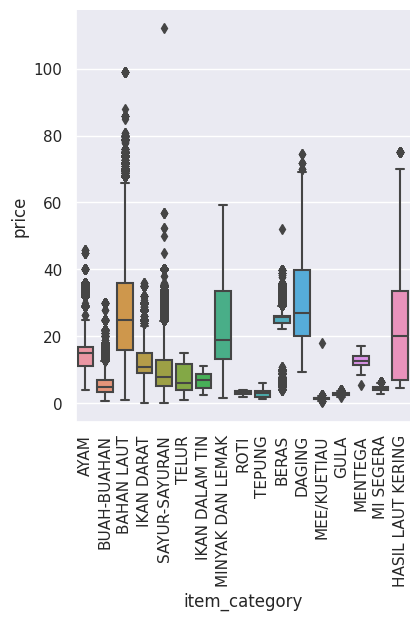

In [278]:
sns.catplot(x="item_category", y="price", kind="box", data=df)
plt.xticks(rotation=90)
# Display the plot
plt.show()

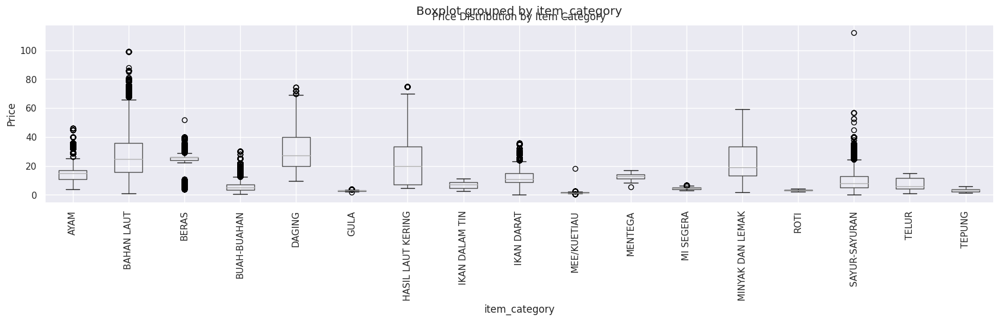

In [279]:
df.boxplot(column='price', by='item_category')
plt.ylabel('Price')
plt.title('Price Distribution by Item Category')
plt.xticks(rotation=90)
plt.show()

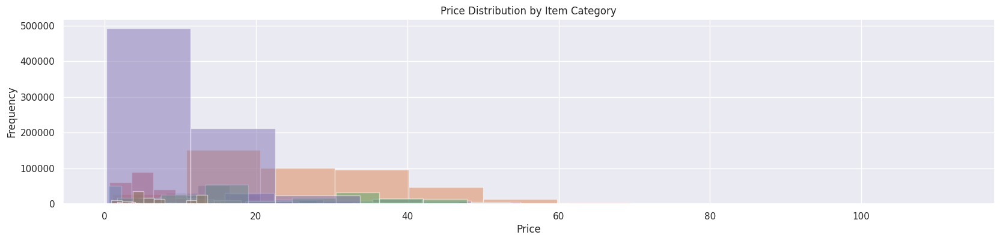

In [280]:
for category, data in df.groupby('item_category'):
    plt.hist(data['price'], bins=10, alpha=0.5, label=category)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Price Distribution by Item Category')
plt.show()

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


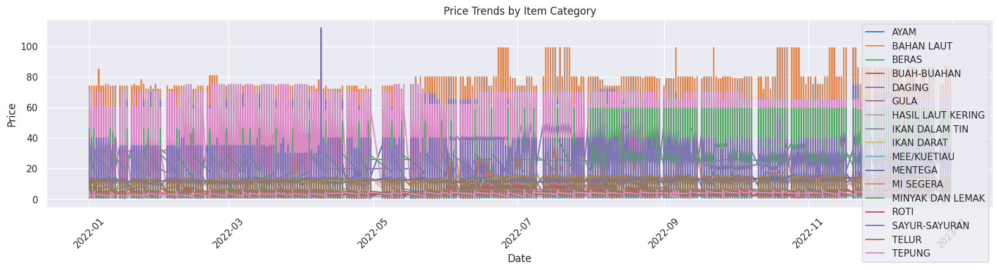

In [281]:
for category, data in df.groupby('item_category'):
    plt.plot(data['date'], data['price'], label=category)
plt.xlabel('Date')
plt.ylabel('Price')
plt.title('Price Trends by Item Category')
plt.legend()
plt.xticks(rotation=45)
plt.show()